# RPM Tumor Time Series Velocity WITHOUT DOUBLETS

In [1]:
# import mazebox as mb
import scvelo as scv
import scanpy as sc
import os.path as op
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import sys
import dropkick as dk
# make sure to use position 1
sys.path.insert(1, "/Users/smgroves/Documents/GitHub/Groves-CellSys2021/")
import mazebox as mb
import cellrank as cr
import scanorama
from typing import Any
from copy import copy
from anndata import AnnData
import scipy.sparse as sp
from cellrank.tl.kernels import VelocityKernel
import warnings

warnings.simplefilter("ignore", category=UserWarning)
warnings.simplefilter("ignore", category=FutureWarning)
warnings.simplefilter("ignore", category=DeprecationWarning)

In [2]:
adata = cr.read('../../data/M2/adata_03_filtered.h5ad')

/var/folders/vh/xk34gq593k53lzm7wlyg64xw0000gn/T/ipykernel_66823/1981719340.py:1: DeprecationWarning: `cellrank.tl.read` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  adata = cr.read('../../data/M2/adata_03_filtered.h5ad')


In [3]:
adata

AnnData object with n_obs × n_vars = 4388 × 15728
    obs: 'doublet_scores', 'predicted_doublets', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'M', 'E', 'clusters_gradients', 'S_score', 'G2M_score', 'phase', 'cell_cycle_diff', 'dropkick_score', 'dropkick_label', 'arcsinh_n_genes_by_counts', 'brcd', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS.enrichment', 'TSS.percentile', 'barcode', 'sample', 'ATAC_snn_res.0.5', 'seurat_clusters', 'nCount_peaks', 'nFeature_peaks', 'peaks_snn_res.0.5', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.5', 'SCT.weight', 'peaks.weight', 'nCount_Imputed_counts', 'nFeature_Imputed_counts', 'nCount_gene_activity', 'nFeature_gene_activity', 'NE_score1', 'identity', 'non.NE_score1', 'comb.score', 'S.Score', 'G2M.Score', 'Phase', 'old.ident', 'wsnn_res.0.5', 'specialists_pca_diffdist'
    var: 'Accession', 'Chromosome', 'End', 'Start', '

From this point, we will run RNA velocity and CellRank in three ways. 
- First, we will just use the basic dynamical model + a kernel for DPT. We will try different weights on the kernels.
- Second, we will try using differential kinetics, to make sure that each timepoint is being adequately fit with scVelo.
- Third, we will apply RNA velocity to each timepoint independently, and then recombine all of the data with the velocity information by timepoint. We will then try to use this in CellRank. If I can get this to work, I'm partial to this method.

In [16]:
adata = adata[adata.obs.predicted_doublets == "False"]

Note: `adata` now refers to the object without doublets!

## Add Debbie's UMAP

In [82]:
umap = pd.read_csv('debbie_umap.csv', header = 0, index_col=0)

In [98]:
umap_1 = umap.loc[[i for i in umap.index if i[-1] == '1']]
umap_2 = umap.loc[[i for i in umap.index if i[-1] == '2']]

In [101]:
umap_2.index = [i[:-2] for i in umap_2.index]

In [102]:
umap_2

,wnnumap_1,wnnumap_2
AAACAGCCACAGGGAC,-7.870077,1.938419
AAACAGCCATGCATAT,-4.900531,-2.904787
AAACATGCAAGGTAAC,-5.477030,1.144867
AAACATGCACCTAAGC,-5.913084,-1.707036
AAACATGCAGCCTAAC,-4.035572,-3.824489
...,...,...
TTTGTGAAGTAAACCC,-6.056884,-1.728760
TTTGTGGCATGGCCCA,-7.845297,-1.058972
TTTGTGTTCCTTAGGG,-7.940131,2.205287
TTTGTGTTCGGCCATA,-7.056906,-2.121831


In [103]:
umap_list_x = []
umap_list_y = []


for i, r in adata.obs.iterrows():
    adata_label = i.split(':')[1][:-1]
    if adata_label in umap_2.index:
        umap_list_x.append(umap_2.loc[adata_label,'wnnumap_1'])
        umap_list_y.append(umap_2.loc[adata_label,'wnnumap_2'])


In [115]:
umap_2 = np.array([umap_list_x, umap_list_y]).T

In [119]:
adata.obsm['X_umap_wnn'] = umap_2

# Velocity 

In [18]:
scv.pp.neighbors(adata) # subsetting corrupted neighborhood graph-- redo here
scv.pp.moments(adata)
# scv.tl.velocity(adata, mode = 'deterministic', groupby='cline')
# scv.tl.velocity_graph(adata)
scv.tl.recover_dynamics(adata, n_jobs=8) #uses velocity genes from deterministic model as default
scv.tl.velocity(adata, mode="dynamical")
scv.tl.velocity_graph(adata)

computing neighbors


OMP: Info #271: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
Trying to set attribute `.uns` of view, copying.


    finished (0:00:11) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 8/16 cores)


  0%|          | 0/2041 [00:00<?, ?gene/s]

    finished (0:03:31) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:08) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/16 cores)


  0%|          | 0/4330 [00:00<?, ?cells/s]

    finished (0:00:45) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


saving figure to file ./figures/scvelo_confidence.png


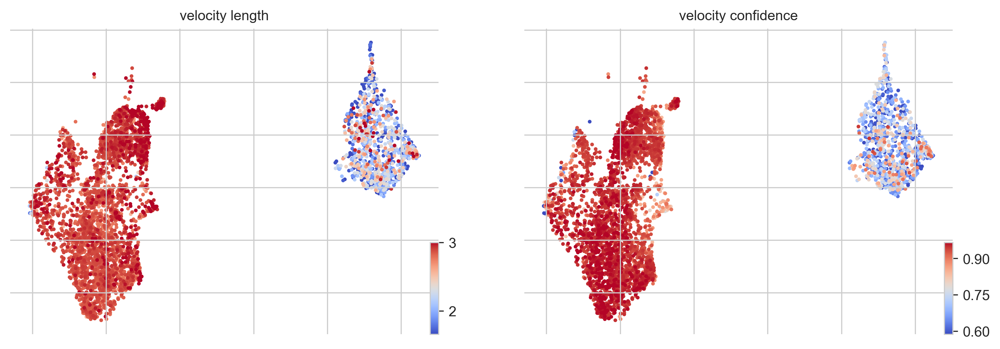

In [120]:
# scv.tl.velocity_confidence(adata)

keys = 'velocity_length', 'velocity_confidence'  
scv.pl.scatter(adata, c=keys, cmap='coolwarm', perc=[5, 95], basis = 'umap_wnn',
                 dpi = 300, save = 'confidence.png')



computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap_wnn', embedded velocity vectors (adata.obsm)
saving figure to file figures/identity_grid.png


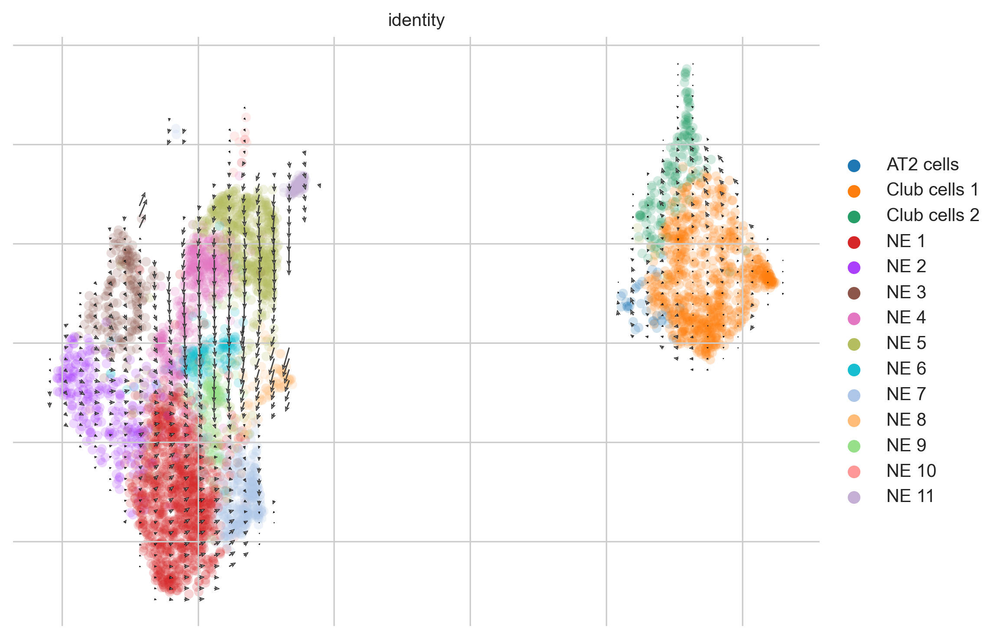

In [121]:
scv.pl.velocity_embedding_grid(adata, vkey='velocity',basis = 'umap_wnn', figsize = (8,6), legend_loc = 'on right',color = 'identity',
                              dpi = 300, save = 'figures/identity_grid.png')


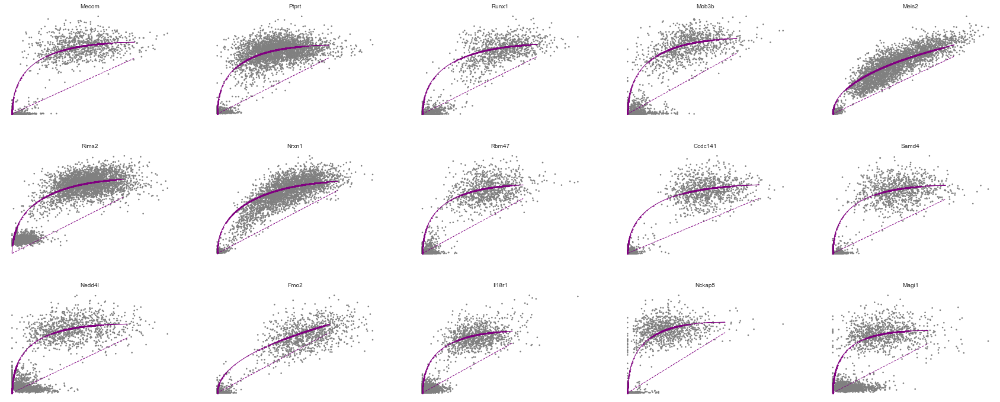

In [21]:
top_genes = adata.var['fit_likelihood'].sort_values(ascending=False).index
scv.pl.scatter(adata, basis=top_genes[:15], ncols=5, frameon=False)

saving figure to file figures/phase_stream.png


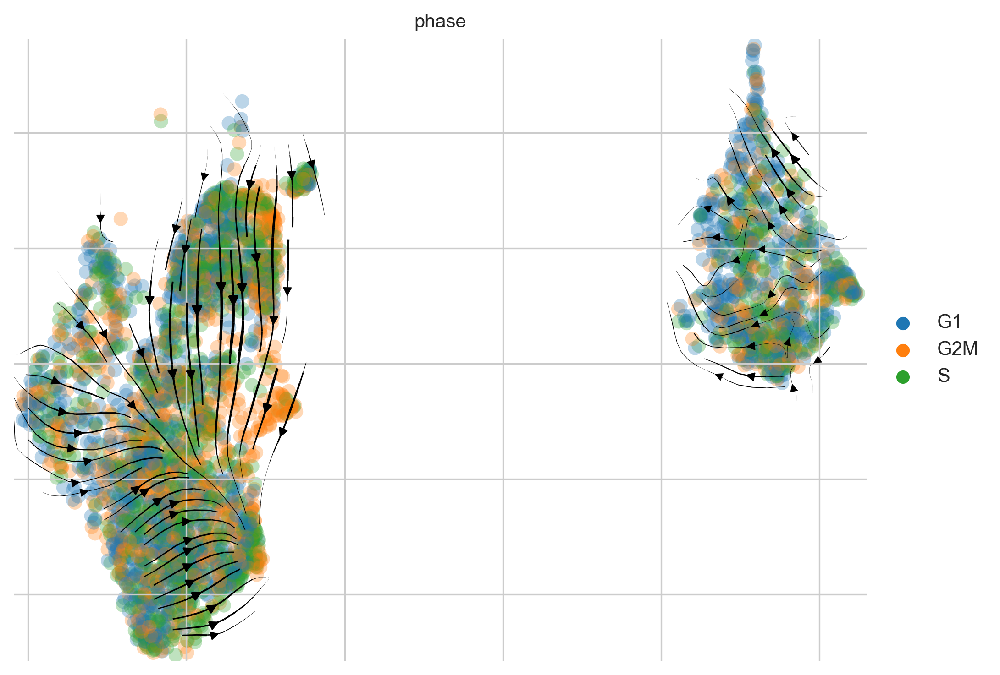

In [122]:
scv.pl.velocity_embedding_stream(adata, vkey='velocity',basis = 'umap_wnn', figsize = (8,6), legend_loc = 'on right',color = 'phase',
                              dpi = 300, save = 'figures/phase_stream.png')


Let's save the data at this point.

In [129]:
adata

AnnData object with n_obs × n_vars = 4330 × 15728
    obs: 'doublet_scores', 'predicted_doublets', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'M', 'E', 'clusters_gradients', 'S_score', 'G2M_score', 'phase', 'cell_cycle_diff', 'dropkick_score', 'dropkick_label', 'arcsinh_n_genes_by_counts', 'brcd', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS.enrichment', 'TSS.percentile', 'barcode', 'sample', 'ATAC_snn_res.0.5', 'seurat_clusters', 'nCount_peaks', 'nFeature_peaks', 'peaks_snn_res.0.5', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.5', 'SCT.weight', 'peaks.weight', 'nCount_Imputed_counts', 'nFeature_Imputed_counts', 'nCount_gene_activity', 'nFeature_gene_activity', 'NE_score1', 'identity', 'non.NE_score1', 'comb.score', 'S.Score', 'G2M.Score', 'Phase', 'old.ident', 'wsnn_res.0.5', 'specialists_pca_diffdist', 'velocity_self_transition', 'velocity_length', 'velo

In [131]:
#ignore on rerun
# adata.uns = {'brcd_colors':adata.uns['brcd_colors'],
#             'clusters_gradients_colors':adata.uns['clusters_gradients_colors'],
#             'dropkick_args':adata.uns['dropkick_args'],
#             'dropkick_thresholds':adata.uns['dropkick_thresholds'],
#             'identity_colors':adata.uns['identity_colors'],
#             'neighbors':adata.uns['neighbors'],
#             'pca':adata.uns['pca'],
#             'phase_colors':adata.uns['phase_colors'],
#             'predicted_doublets_colors':adata.uns['predicted_doublets_colors'],
#             'umap':adata.uns['umap'],
#             'recover_dynamics':adata.uns['recover_dynamics'],
#             'velocity_params':adata.uns['velocity_params'],
#             'velocity_graph':adata.uns['velocity_graph'],
#             'velocity_graph_neg':adata.uns['velocity_graph_neg'],
#             'schur_matrix_fwd':adata.uns['schur_matrix_fwd'],
#             'eigendecomposition_fwd':adata.uns['eigendecomposition_fwd'],
#             'terminal_states_colors':adata.uns['terminal_states_colors'],
#             'paga':adata.uns['paga'],
#             'identity_sizes':adata.uns['identity_sizes'],
#             'None_TM':adata.uns['None_TM'], 
#             }

In [132]:
adata.write_h5ad('../../data/M2/adata_04_nodub.h5ad')



In [17]:
adata = sc.read_h5ad('../../data/M2/adata_04_nodub.h5ad')



## Kinetic Rate Parameters

In [25]:
adata

AnnData object with n_obs × n_vars = 4330 × 15728
    obs: 'doublet_scores', 'predicted_doublets', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'M', 'E', 'clusters_gradients', 'S_score', 'G2M_score', 'phase', 'cell_cycle_diff', 'dropkick_score', 'dropkick_label', 'arcsinh_n_genes_by_counts', 'brcd', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS.enrichment', 'TSS.percentile', 'barcode', 'sample', 'ATAC_snn_res.0.5', 'seurat_clusters', 'nCount_peaks', 'nFeature_peaks', 'peaks_snn_res.0.5', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.5', 'SCT.weight', 'peaks.weight', 'nCount_Imputed_counts', 'nFeature_Imputed_counts', 'nCount_gene_activity', 'nFeature_gene_activity', 'NE_score1', 'identity', 'non.NE_score1', 'comb.score', 'S.Score', 'G2M.Score', 'Phase', 'old.ident', 'wsnn_res.0.5', 'specialists_pca_diffdist', 'velocity_self_transition', 'velocity_length', 'velo

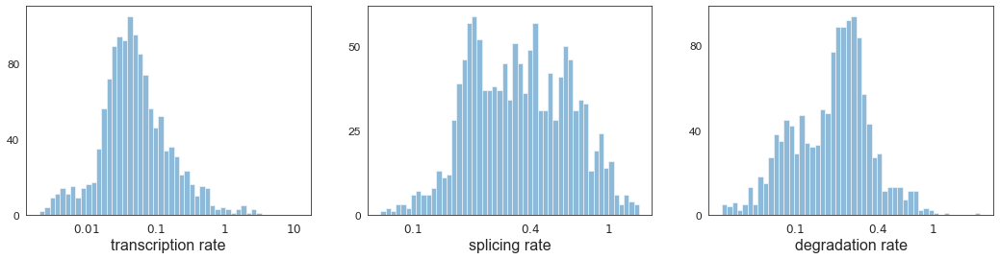

,fit_r2,fit_alpha,fit_beta,fit_gamma,fit_t_,fit_scaling,fit_std_u,fit_std_s,fit_likelihood,fit_u0,fit_s0,fit_pval_steady,fit_steady_u,fit_steady_s,fit_variance,fit_alignment_scaling
Gene,,,,,,,,,,,,,,,,
AC133103.1,0.150705,0.013749,0.271651,0.178890,6.414564,1.667336,0.016318,0.012192,0.000003,0.0,0.0,0.305918,0.051043,0.034354,1.701378,2.528580
Mybl1,0.506590,0.174553,0.329468,0.479600,7.694229,0.830817,0.139449,0.079307,0.234916,0.0,0.0,0.361720,0.437253,0.220260,0.949829,1.726170
Arfgef1,0.122128,0.079278,0.036766,0.076766,18.145716,4.448933,0.522824,0.193903,0.240040,0.0,0.0,0.191504,1.939567,0.530193,0.895585,10.591723
Eya1,0.713913,0.017720,0.009212,0.088721,32.444184,21.676330,0.563313,0.042879,0.347966,0.0,0.0,0.000042,1.748123,0.119054,0.423066,6.021886
Pkhd1,0.827422,0.035033,0.011826,0.117909,23.928573,21.227681,0.860895,0.066916,0.324307,0.0,0.0,0.000837,2.549746,0.187078,0.491727,5.457465


In [26]:
df = adata.var
df = df[(df['fit_likelihood'] > .1) & df['velocity_genes'] == True]

kwargs = dict(xscale='log', fontsize=16)
with scv.GridSpec(ncols=3) as pl:
    pl.hist(df['fit_alpha'], xlabel='transcription rate', **kwargs)
    pl.hist(df['fit_beta'] * df['fit_scaling'], xlabel='splicing rate', xticks=[.1, .4, 1], **kwargs)
    pl.hist(df['fit_gamma'], xlabel='degradation rate', xticks=[.1, .4, 1], **kwargs)

scv.get_df(adata, 'fit*', dropna=True).head()

In [27]:
df

,Accession,Chromosome,End,Start,Strand,gene_count_corr,dropkick_coef,mito,pct_dropout_by_counts,ambient,...,fit_std_s,fit_likelihood,fit_u0,fit_s0,fit_pval_steady,fit_steady_u,fit_steady_s,fit_variance,fit_alignment_scaling,velocity_genes
Gene,,,,,,,,,,,,,,,,,,,,,
Mybl1,ENSMUSG00000025912,1,9700209,9667415,-,0.1193,NaN,False,91.035818,False,...,0.079307,0.234916,0.0,0.0,0.361720,0.437253,0.220260,0.949829,1.726170,True
Arfgef1,ENSMUSG00000067851,1,10232670,10137571,-,-0.0417,NaN,False,63.330106,False,...,0.193903,0.240040,0.0,0.0,0.191504,1.939567,0.530193,0.895585,10.591723,True
Ogfrl1,ENSMUSG00000026158,1,23397772,23366424,-,0.0035,0.00000,False,81.297193,False,...,0.131304,0.240230,0.0,0.0,0.184386,0.188103,0.354782,0.950892,1.579553,True
Fam135a,ENSMUSG00000026153,1,24100341,24011093,-,0.0214,NaN,False,88.151016,False,...,0.074392,0.362476,0.0,0.0,0.008488,1.128679,0.199810,0.401891,6.570550,True
Rev1,ENSMUSG00000026082,1,38129801,38052786,-,-0.0076,NaN,False,81.684414,False,...,0.114820,0.409611,0.0,0.0,0.032733,1.231999,0.261709,0.338500,7.148205,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Tbc1d8b,ENSMUSG00000042473,X,139753405,139684996,+,0.0377,NaN,False,94.966118,False,...,0.034780,0.243131,0.0,0.0,0.055217,0.550561,0.093950,0.927648,4.616232,True
Vsig1,ENSMUSG00000031430,X,140939472,140907608,+,0.0054,0.03302,False,99.341723,False,...,0.017538,0.155450,0.0,0.0,0.002362,0.122677,0.047762,1.046804,1.472698,True
Map3k15,ENSMUSG00000031303,X,160123351,159988433,+,-0.0094,NaN,False,86.118103,False,...,0.106512,0.305826,0.0,0.0,0.060603,0.918842,0.280624,0.597111,7.228440,True


In [28]:
df = scv.get_df(adata, 'fit*', dropna=True).sort_values('fit_likelihood', ascending=False)

In [29]:
df2 = df[ 'fit_likelihood'] #take only fit_like column
df2.index = df2.index.str.upper() #make index strs uppercase
df2.to_csv('fitlikelihood_noheader_caps.csv', header=None, sep='\t') #save df to csv

In [9]:
df2 = pd.read_csv('fitlikelihood_noheader_caps.csv', header=None, sep='\t') #save df to csv

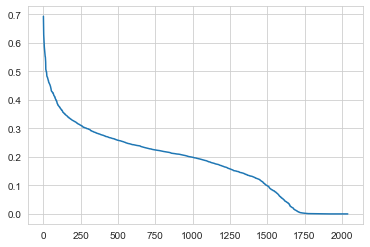

In [30]:
sns.set_style('whitegrid')
plt.plot(range(len(df.index)), df.fit_likelihood)
plt.savefig('./figures/fit_likelihoods_cdf.pdf')

In [20]:
for i in df.index:
    if df.loc[i, 'fit_likelihood'] > 0.3:
        print(i) 
    else: break

Mecom
Ptprt
Mob3b
Nckap5
Runx1
Rims2
Nrxn1
Meis2
Nedd4l
Fmo2
Samd4
Prdm16
Ccdc141
Atp11a
Rbm47
Sox5
Il18r1
Magi1
Cdh13
Plcl2
Eya2
Gabrp
Ptpn13
Mctp2
Trpm6
Dock8
Celf4
Epsti1
Fgf14
Pard3b
Cacna1a
Rarb
Mtus1
Ntn4
Hcn1
B430010I23Rik
Smad3
Cacna2d1
Rapgef4
Pclo
Esr1
Sntb1
Selenbp1
Cyp2f2
Tox
Scgb1a1
Lpp
Nectin3
Cadps
Zfp618
Sema3a
Ahr
Wwc2
Pde3b
Sp100
Ddc
Mdfic
Col23a1
Pon3
Arhgap44
Slc8a1
Tc2n
Piezo2
Snap25
Col4a5
Alcam
Nfia
Rai14
Syt1
Ppp1r14c
Nfix
Dmd
Ttc6
Stxbp6
Pcsk1
Mgst1
Dennd4a
Por
Dapk1
Cacna1c
Nlgn1
Gnao1
Eya1
Wwtr1
Col8a1
St18
Resf1
Atp8b1
Dhrs3
Zfp809
Vwf
Irak2
Yap1
Smad6
Rev1
Kitl
Scn3a
Gprin3
Runx1t1
Tspan11
Ahi1
Ank
Acss1
Clip4
Slc4a5
Tcerg1l
Cacna2d3
Ikzf2
Npas2
Snx30
Nol4
Itprid1
Bmp5
Aox1
Sel1l3
Arhgap24
Ptprn2
Cdh20
Chd7
Sh2d4a
Rgs7
Fam135a
Dapk2
Ccdc88a
Unc79
Sdc1
Hspa4l
Mical3
Asap3
Iqgap2
Cplx2
Limch1
Dner
Pex5l
Tmem243
Unc80
Stox2
Ptpn14
Slc38a1
D230025D16Rik
Ncam1
Cdc14a
Dnajc6
Abcc3
Upk3a
Spats2l
Pon2
Ryr2
Dpp4
Sftpb
Kifc3
Robo1
Smad7
Pkhd1
Epha4
Myo1d
Vegfa
Spp1
E

## CellRank

saving figure to file ./figures/scvelo_subtypes_arcs_stream.png


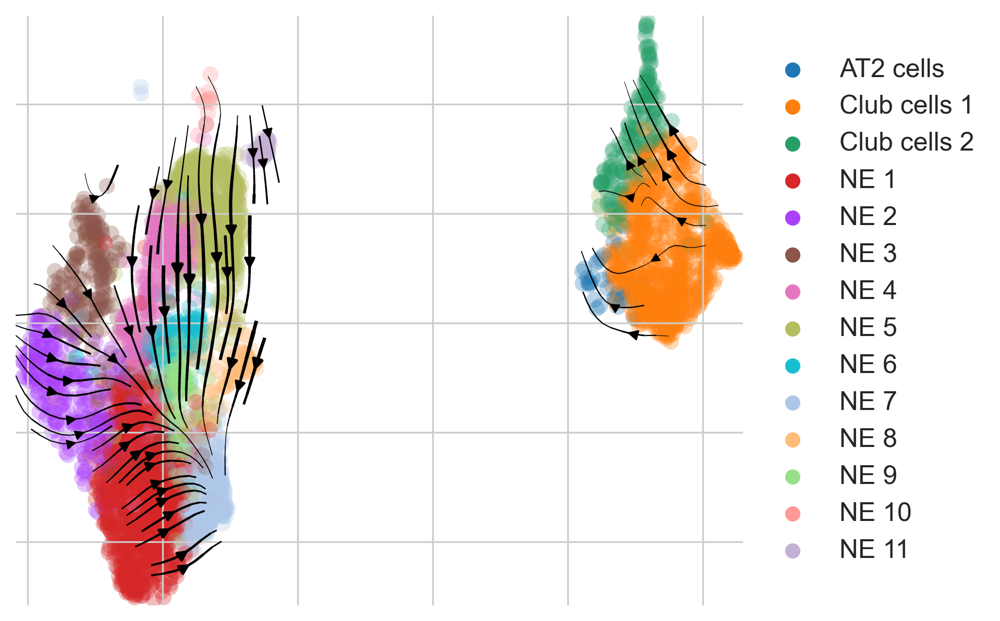

In [133]:
scv.pl.velocity_embedding_stream(
    adata, basis="umap_wnn", color = ['identity'], legend_fontsize=12, title="", smooth=0.8, min_mass=4, 
    legend_loc = 'on right', dpi = 300, figsize = (6,5),
    save = 'subtypes_arcs_stream.png'
)

saving figure to file figures/top_gene_fits_subtypes.png


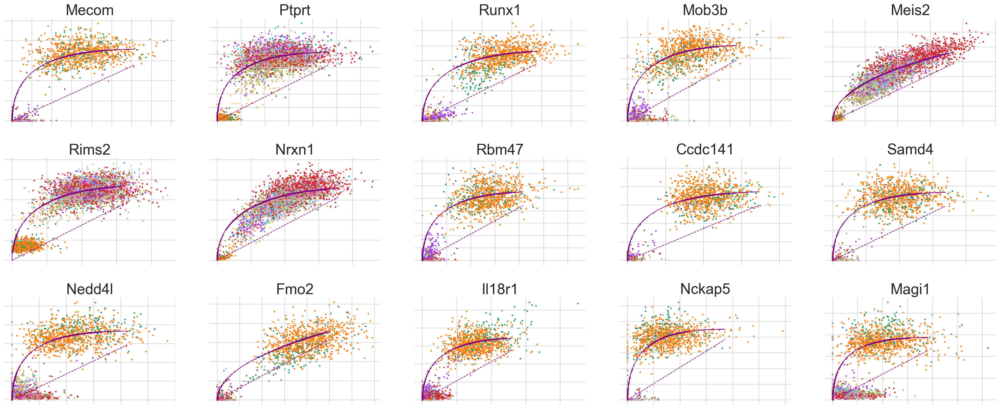

In [32]:
#Fit Genes
# top_genes = adata.var['fit_likelihood'].sort_values(ascending=False).index

scv.pl.scatter(adata, basis=top_genes[:15], ncols=5, frameon=False, color = 'identity', save = "figures/top_gene_fits_subtypes.png",
               fontsize = 25,size = 30,
               dpi = 150)

In [33]:
vk = VelocityKernel(adata)
vk.compute_transition_matrix()

  0%|          | 0/4330 [00:00<?, ?cell/s]

  0%|          | 0/4330 [00:00<?, ?cell/s]

<VelocityKernel>

In [34]:
# combined_kernel = 0.8 * vk + 0.2* k
from cellrank.tl.estimators import GPCCA

g = GPCCA(vk)
g.compute_schur(n_components=20)
print(g)

GPCCA[n=4330, kernel=<VelocityKernel[softmax_scale=1.69, mode=deterministic, seed=2732, scheme=<CorrelationScheme>]>]


## Macrostates: timepoints

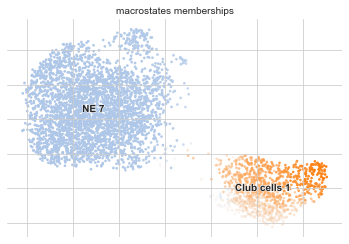

Defaulting to `'gmres'` solver.


  0%|          | 0/2 [00:00<?, ?/s]

In [35]:
g.compute_macrostates(cluster_key="identity") 
g.plot_macrostates()
g.compute_terminal_states() 
g.compute_absorption_probabilities(solver="gmres", use_petsc=True)

In [36]:
scv.tl.paga(
    adata,
    groups="identity",
    root_key="initial_states_probs",
    end_key="terminal_states_probs",
    # use_time_prior="Diffusion Pseudotime",
)

running PAGA using priors: ['velocity_pseudotime', 'terminal_states_probs']
    finished (0:00:01) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


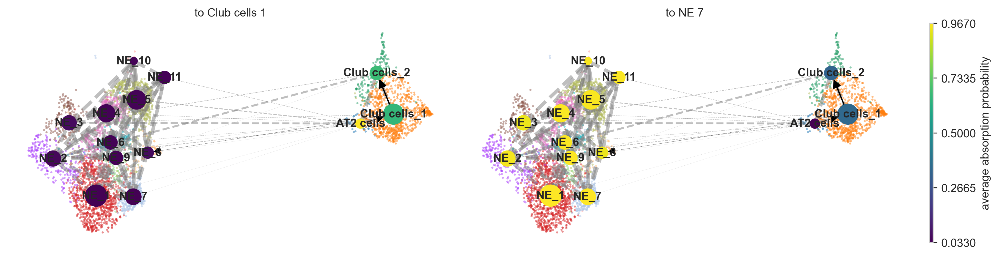

In [134]:
cr.pl.cluster_fates(
    adata,
    mode="paga",
    cluster_key="identity",
    basis="umap_wnn",
    legend_kwargs={"loc": "top right out"},
    legend_loc="on data",
    node_size_scale=1,
    edge_width_scale=1,
    max_edge_width=3,
    title="Directed PAGA",figsize = (12, 3),
dpi = 300, save = './figures/paga_timepoint.png')

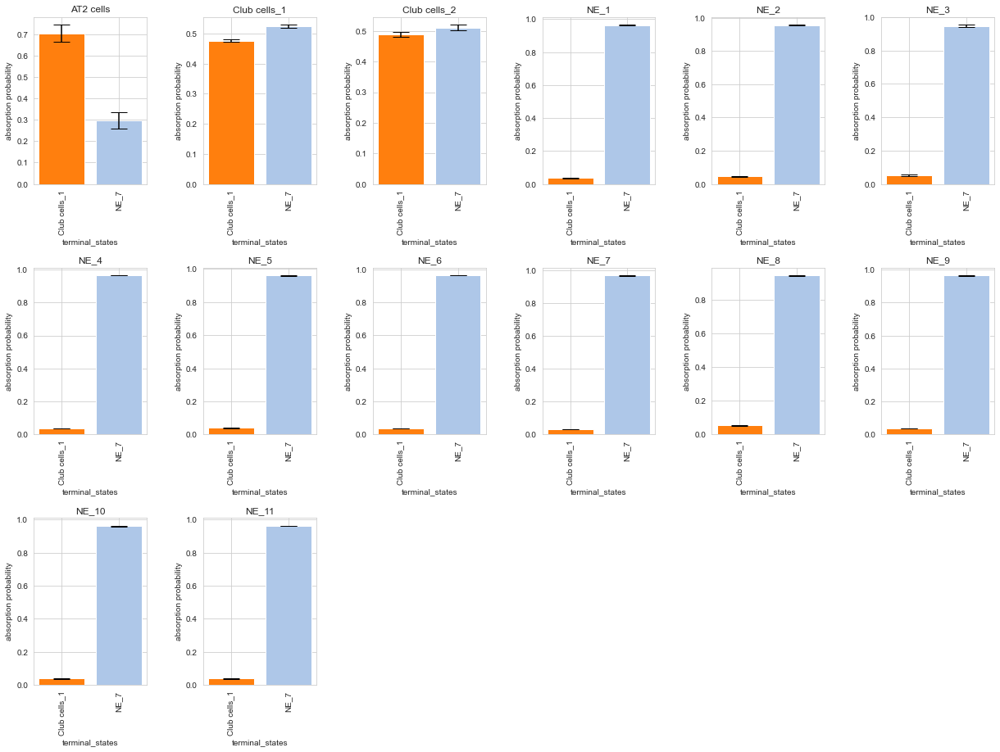

In [38]:
cr.pl.cluster_fates(
    adata,
    mode="bar",
    cluster_key="identity",
    basis="umap", ncols = 6, save = './figures/paga_bar_timepoint.pdf')


# Lineage drivers

In [79]:
# g.write('../../out/RPM-time-series/GPCCA')

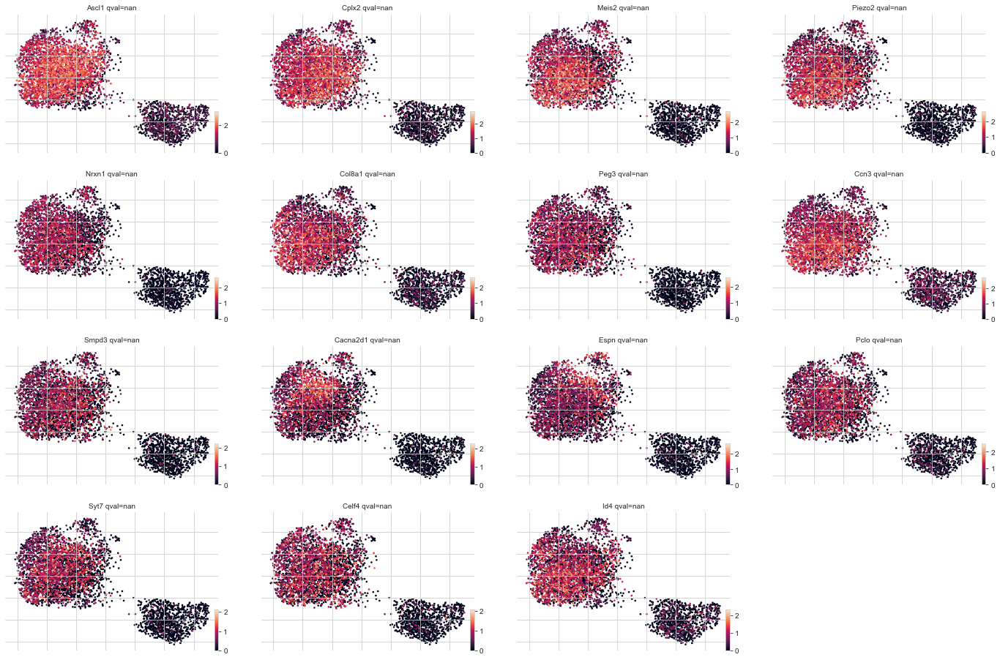

In [135]:
drivers = g.compute_lineage_drivers(lineages=["Club cells_1",'NE_7'], return_drivers=True)  #when running macrostates and terminal states by timepoint
drivers.sort_values(by="NE_7_corr", ascending=False)
g.plot_lineage_drivers("NE_7", n_genes=15, )

In [56]:
drivers.sort_values(by="NE_7_corr", ascending=False).drop(labels=["Club cells_1_qval","NE_7_qval"],axis = 1).dropna().to_csv("drivers_nodub.csv")


## Gene trends

In [57]:
adata

AnnData object with n_obs × n_vars = 4330 × 15728
    obs: 'doublet_scores', 'predicted_doublets', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'M', 'E', 'clusters_gradients', 'S_score', 'G2M_score', 'phase', 'cell_cycle_diff', 'dropkick_score', 'dropkick_label', 'arcsinh_n_genes_by_counts', 'brcd', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS.enrichment', 'TSS.percentile', 'barcode', 'sample', 'ATAC_snn_res.0.5', 'seurat_clusters', 'nCount_peaks', 'nFeature_peaks', 'peaks_snn_res.0.5', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.5', 'SCT.weight', 'peaks.weight', 'nCount_Imputed_counts', 'nFeature_Imputed_counts', 'nCount_gene_activity', 'nFeature_gene_activity', 'NE_score1', 'identity', 'non.NE_score1', 'comb.score', 'S.Score', 'G2M.Score', 'Phase', 'old.ident', 'wsnn_res.0.5', 'specialists_pca_diffdist', 'velocity_self_transition', 'velocity_length', 'velo

  0%|          | 0/2 [00:00<?, ?gene/s]

/Users/smgroves/Documents/anaconda3/envs/multiome/lib/python3.9/site-packages/pygam/utils.py:649: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  bases = (x >= aug_knots[:-1]).astype(np.int) * \
/Users/smgroves/Documents/anaconda3/envs/multiome/lib/python3.9/site-packages/pygam/utils.py:650: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify th

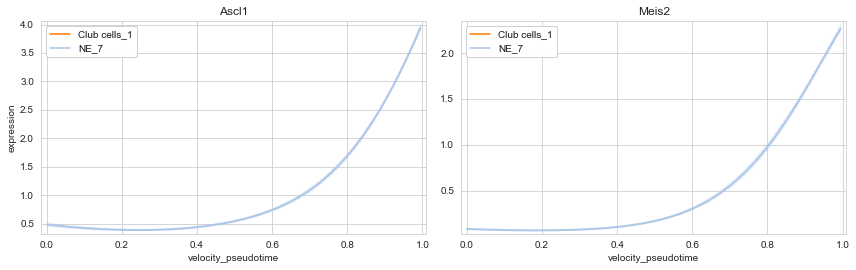

In [136]:
model = cr.ul.models.GAM(adata)

cr.pl.gene_trends(
    adata,
    model,
    ["Ascl1", "Meis2"],
    data_key="Ms",
    time_key="velocity_pseudotime",
    show_progress_bar=False,
    save = '2_gene_trends_ASCL1_MEIS2.png',
    same_plot = True,
    hide_cells=True
)

In [ ]:
tfs = ['Prdm16','Mecom','Runx1','Ahr','Esr1','Rarb','Npas2','Tcf7l2','Nfia','Sox5','Meis2','Prox1','Ascl1','Tbx15','Rorb','Jund','Fosb','Jun','Fos',
       'Junb','Egr1','Kmt2a','Lmx1b','Nfatc2','Bach1','Hif1a','Hsf2','Six1','Six4','Ets1','Pknox2','Cux2','Tfdp1','Nfib','Pbx1','Tcf12','Zbtb20','Creb1',
       'Bbx','Kdm2a','Lcor','Trps1','Nr3c2','Tcf4','Sox6','Zeb1','Epas1','Smad3','Sp100','Nfix','Bach2','Foxo3','Glis3','Ehf','Nfe2l2','Tcf7l1','Arid5b','Thrb',
       'Cux1','Grhl2','Stat1','Stat2','Nr6a1','Tead1','Nfkb1','Nfyc','Stat4','Pparg']

  0%|          | 0/68 [00:00<?, ?gene/s]

/Users/smgroves/Documents/anaconda3/envs/multiome/lib/python3.9/site-packages/pygam/utils.py:649: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  bases = (x >= aug_knots[:-1]).astype(np.int) * \
/Users/smgroves/Documents/anaconda3/envs/multiome/lib/python3.9/site-packages/pygam/utils.py:650: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify th

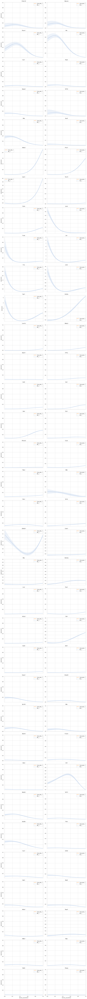

In [137]:
cr.pl.gene_trends(
    adata,
    model,
    tfs,
    data_key="Ms",
    time_key="velocity_pseudotime",
    show_progress_bar=False,
    save = 'gene_trends.png',
    same_plot = True,
    hide_cells=True
)

In [79]:
adata.obs['velocity_pseudotime'].to_csv('velocity_pseudotime.csv')

# Key TFs for network

In [58]:
tfs = ['Prdm16','Mecom','Runx1','Ahr','Esr1','Rarb','Npas2','Tcf7l2','Nfia','Sox5','Meis2','Prox1','Ascl1','Tbx15','Rorb','Jund','Fosb','Jun','Fos',
       'Junb','Egr1','Kmt2a','Lmx1b','Nfatc2','Bach1','Hif1a','Hsf2','Six1','Six4','Ets1','Pknox2','Cux2','Tfdp1','Nfib','Pbx1','Tcf12','Zbtb20','Creb1',
       'Bbx','Kdm2a','Lcor','Trps1','Nr3c2','Tcf4','Sox6','Zeb1','Epas1','Smad3','Sp100','Nfix','Bach2','Foxo3','Glis3','Ehf','Nfe2l2','Tcf7l1','Arid5b','Thrb',
       'Cux1','Grhl2','Stat1','Stat2','Nr6a1','Tead1','Nfkb1','Nfyc','Stat4','Pparg']

In [59]:
print("Length of overlap:", len(set(tfs).intersection(set(adata.var_names))))
print("Length of tfs:",len(tfs))

Length of overlap: 68
Length of tfs: 68


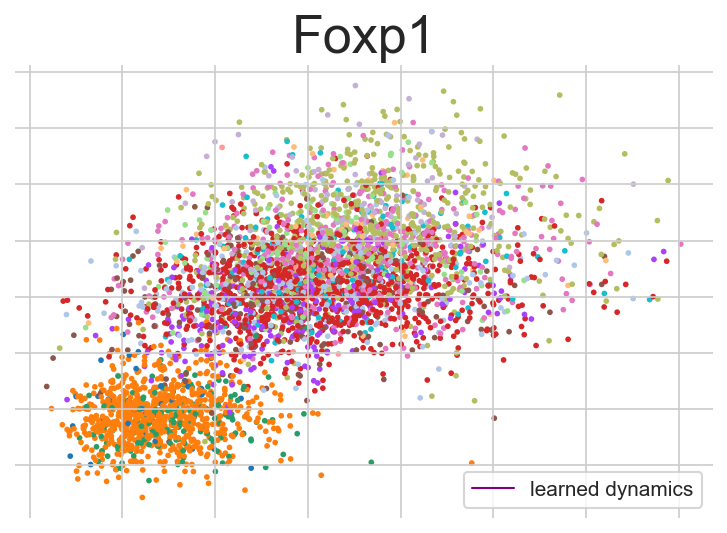

In [60]:
scv.pl.scatter(adata,'Foxp1', ncols=5, frameon=False, color = 'identity',
               fontsize = 25,size = 30,
               dpi = 150)

saving figure to file figures/tf_fits.png


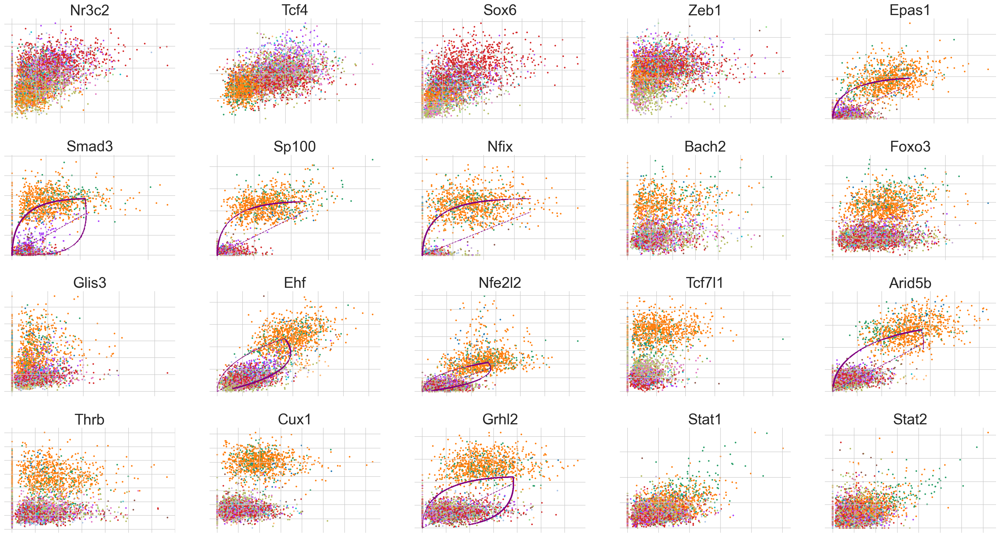

In [61]:
scv.pl.scatter(adata,tfs[42:62], ncols=5, frameon=False, color = 'identity', save = "figures/tf_fits.png",
               fontsize = 25,size = 30,
               dpi = 150)

saving figure to file figures/tf_fits2.png


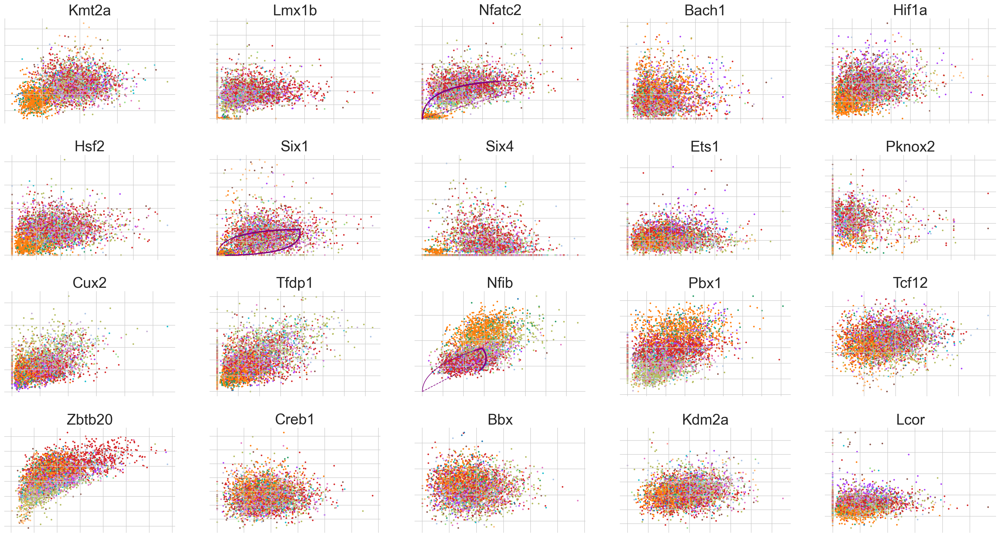

In [62]:
scv.pl.scatter(adata,tfs[21:41], ncols=5, frameon=False, color = 'identity', save = "figures/tf_fits2.png",
               fontsize = 25,size = 30,
               dpi = 150)

saving figure to file figures/tf_fits3.png


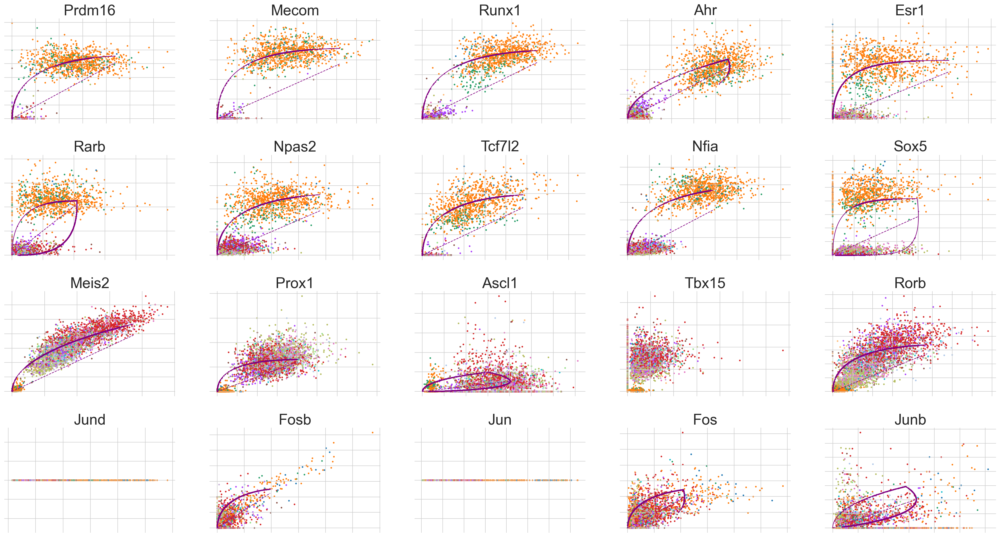

In [63]:
scv.pl.scatter(adata,tfs[0:20], ncols=5, frameon=False, color = 'identity', save = "figures/tf_fits3.png",
               fontsize = 25,size = 30,
               dpi = 150)

saving figure to file figures/tf_fits4.png


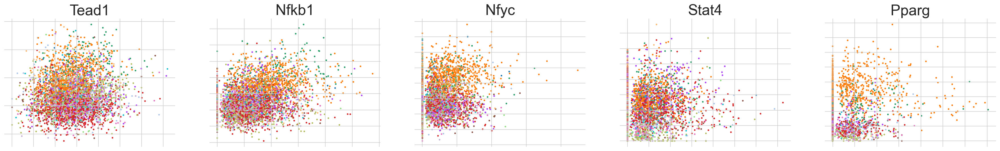

In [64]:
scv.pl.scatter(adata,tfs[63:68], ncols=5, frameon=False, color = 'identity', save = "figures/tf_fits4.png",
               fontsize = 25,size = 30,
               dpi = 150)

## Debbie's favorite genes
From email on June 22, 2022:
    
    As for the TFs, I further filtered the TF list I gave you and assess which TFs have correlated expression in order to uncover regulatory networks. This is how that looks:

    There is of course a lot in this plot, but the middle square is the most interesting as it is NE TFs. Particularly, we 3-4 distinct NE modules, one having Ascl1, one with Jun/Fos, one with NFIB and few other diffuse ones. Particularly the NFIB cluster on the right appears to be shared with the non-NE cluster on the right suggesting a shared program. It would be cool if you include these TFs in your modeling and see how that turns out. The NE TFs I am most excited about are Meis2, Pbx1, Jun/Fos etc, Rorb, Tcf4 and Tcf12. It would be cool to see how their expression varies with cell movement.



saving figure to file figures/tf_fits_chosen.png


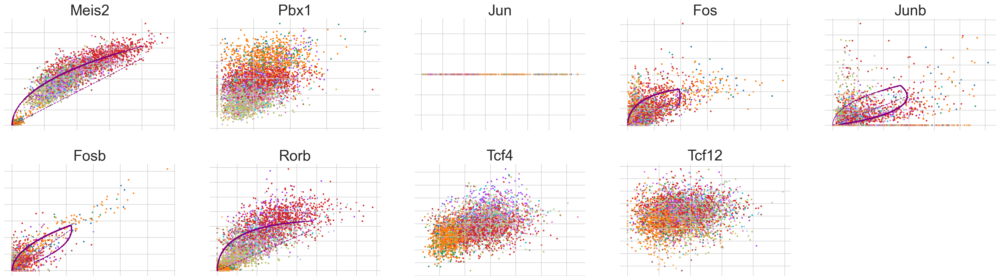

In [59]:
scv.pl.scatter(adata,['Meis2','Pbx1','Jun','Fos','Junb','Fosb','Rorb','Tcf4','Tcf12'], ncols=5, frameon=False, color = 'identity', save = "figures/tf_fits_chosen.png",
               fontsize = 25,size = 30,
               dpi = 150)

### Overlap of TFs from FIGR analysis and velocity genes with high fit likelihood:

In [66]:
df['rank_index'] = np.arange(2041)

In [67]:
overlap_fl = df.loc[list(set(tfs).intersection(set(df.index)))].sort_values('fit_likelihood', ascending = False)
overlap_fl.head()

,fit_r2,fit_alpha,fit_beta,fit_gamma,fit_t_,fit_scaling,fit_std_u,fit_std_s,fit_likelihood,fit_u0,fit_s0,fit_pval_steady,fit_steady_u,fit_steady_s,fit_variance,fit_alignment_scaling,rank_index
Gene,,,,,,,,,,,,,,,,,
Mecom,0.841767,0.034188,0.000952,0.086289,21.791699,281.102916,15.478270,0.085347,0.693732,0.0,0.0,0.045819,34.170180,0.162971,0.113642,6.080413,0
Runx1,0.904422,0.116592,0.025011,0.124094,18.461546,11.059503,2.099077,0.256228,0.628482,0.0,0.0,0.375018,4.541431,0.532281,0.134773,4.880473,2
Meis2,0.827590,0.769704,0.029340,0.153111,21.628916,3.470646,8.039943,1.042450,0.607186,0.0,0.0,0.452093,19.002667,2.274891,0.148484,4.640163,4
Ahr,0.878316,0.287570,0.207738,0.238559,15.917610,0.635695,0.445237,0.330936,0.505677,0.0,0.0,0.419964,1.080777,0.796261,0.217563,3.407595,17
Esr1,0.453354,0.014017,0.008826,0.087658,21.646972,41.571111,0.727026,0.028856,0.468788,0.0,0.0,0.004635,1.582716,0.076072,0.240369,4.497052,32


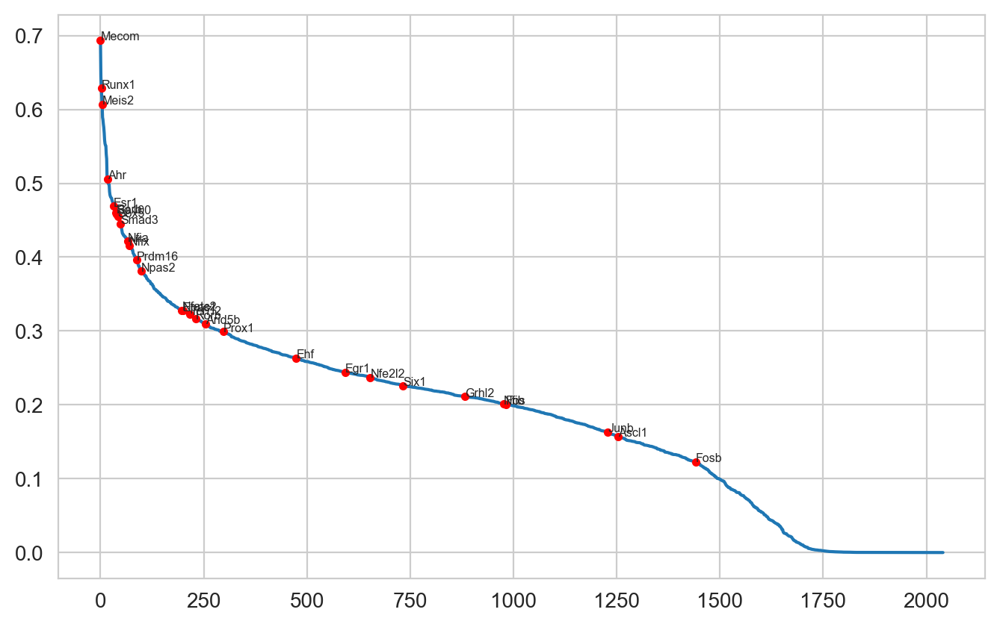

In [76]:
plt.figure(dpi = 200, figsize = (8,5))
plt.plot(range(len(df.index)), df.fit_likelihood)
for i,r in overlap_fl.iterrows():
    plt.text(r['rank_index'], r['fit_likelihood'],i, size = 'xx-small')
    plt.plot(r['rank_index'], r['fit_likelihood'], '.', color = 'red')

plt.savefig("./figures/fit_likelihoods_cdf_labeled.pdf")

### Overlap of TFs from FIGR analysis and ChEA TFs

In [67]:
ChEA_df = pd.read_csv('./enrichr/ChEA_2016_table_fitlikelihoodgenes.txt', delimiter='\t')


In [72]:
ChEA_df

,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,SUZ12 20075857 ChIP-Seq MESCs Mouse,144/4356,3.006921e-24,1.903381e-21,0,0,3.416377,1.850348e+02,PREP;AHR;RORB;SLC4A4;RIMS2;ALCAM;SCN9A;NRCAM;R...
1,ZNF217 24962896 ChIP-Seq MCF-7 Human,79/1522,2.397019e-23,7.586565e-21,0,0,4.543508,2.366497e+02,CHD7;PTPRK;AHR;IKZF2;HNMT;ROBO1;SYNE1;SMPD3;RI...
2,SMAD4 21799915 ChIP-Seq A2780 Human,99/2464,2.755637e-21,5.814395e-19,0,0,3.628465,1.717739e+02,CYFIP2;IKZF2;FGF1;SLC4A4;SLC8A1;CDC14A;RIMS2;A...
3,SMARCD1 25818293 ChIP-Seq ESCs Mouse,89/2119,3.496919e-20,5.533874e-18,0,0,3.689231,1.652769e+02,CYFIP2;PTPRT;GABRB3;ZFP521;WWC2;CELF4;PTPRK;RO...
4,WT1 25993318 ChIP-Seq PODOCYTE Human,115/3464,1.974684e-18,2.243501e-16,0,0,3.051657,1.244042e+02,CYFIP2;IKZF2;FGF1;SLC4A5;SLC8A1;CDC14A;ALCAM;T...
...,...,...,...,...,...,...,...,...,...
628,HOXB4 20404135 ChIP-ChIP EML Mouse,7/1824,9.999950e-01,9.999960e-01,0,0,0.235953,1.172067e-06,FUT8;ZFP521;DOCK8;DNER;PLXNA2;LRRFIP1;DHRS3
629,VDR 23849224 ChIP-Seq CD4+ Human,5/2231,9.999952e-01,9.999960e-01,0,0,0.133510,6.451228e-07,CLIP4;EPSTI1;NAF1;TOX;CPEB2
630,JARID1A 20064375 ChIP-Seq MESCs Mouse,4/2171,9.999952e-01,9.999960e-01,0,0,0.109713,5.262347e-07,ATP7B;D230025D16RIK;DMXL2;CACNA1A
631,ETS1 20019798 ChIP-Seq JURKAT Human,2/1607,9.999956e-01,9.999960e-01,0,0,0.075924,3.344313e-07,SMPD3;NAF1


In [73]:
ChEA_df['tf'] = [i.split(' ')[0] for i in ChEA_df['Term']]

In [86]:
overlap_chea = ChEA_df[ChEA_df['tf'].isin(list(set([i.upper() for i in tfs]).intersection(set(ChEA_df.tf))))]

In [87]:
overlap_chea

,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes,tf
6,TCF4 23295773 ChIP-Seq U87 Human,121/3812,5.519284e-18,4.991009e-16,0,0,2.948578,1.171714e+02,RAB3C;WWC2;AHR;RORB;IKZF2;HNMT;FGF1;SLC8A1;CDC...,TCF4
29,NFE2L2 20460467 ChIP-Seq MEFs Mouse,45/1055,2.018782e-10,4.004261e-09,0,0,3.278612,7.318961e+01,RAB3C;DDC;KHDRBS3;PCX;NRXN1;PREP;SEMA3E;PTPRK;...,NFE2L2
39,SOX6 21985497 ChIP-Seq MYOTUBES Mouse,64/2000,3.185794e-09,4.548629e-08,0,0,2.499033,4.889249e+01,CYFIP2;PREP;FMN2;PTPRK;IKZF2;SYNE1;UNC80;DNER;...,SOX6
45,ESR1 22446102 ChIP-Seq UTERUS Mouse,62/1916,3.909107e-09,5.379271e-08,0,0,2.518250,4.875321e+01,RYR2;PREP;IKZF2;SLC8A1;CDC14A;SYNE1;SMPD3;ALCA...,ESR1
67,SMAD3 21741376 ChIP-Seq ESCs Human,60/2000,1.137358e-07,1.014011e-06,0,0,2.298365,3.674945e+01,PTPRT;RAB3C;CHD7;FMN1;FGF1;ROBO1;RIMS2;PCLO;KI...,SMAD3
...,...,...,...,...,...,...,...,...,...,...
599,STAT4 19710469 ChIP-ChIP TH1 Mouse,14/1939,9.995759e-01,9.999960e-01,0,0,0.453614,1.924118e-04,PON2;LPP;RUNX1;ZFP36L1;SYNE1;DNM3;AHI1;NFIA;BC...,STAT4
614,FOXO3 22982991 ChIP-Seq MACROPHAGES Mouse,11/2000,9.999850e-01,9.999960e-01,0,0,0.340121,5.085481e-06,SMPD3;SP100;ANXA2;DOCK8;HSPA4L;REV1;4930523C07...,FOXO3
617,CREB1 15753290 ChIP-ChIP HEK293T Human,2/957,9.999900e-01,9.999960e-01,0,0,0.132184,1.319296e-06,BCL6;RARB,CREB1
627,CREB1 23762244 ChIP-Seq HIPPOCAMPUS Rat,11/2393,9.999950e-01,9.999960e-01,0,0,0.277703,1.392999e-06,SMPD3;DNM3;RAB3C;SNAP25;DDC;FAM135A;PCLO;PCX;S...,CREB1


<AxesSubplot:xlabel='Adjusted P-value'>

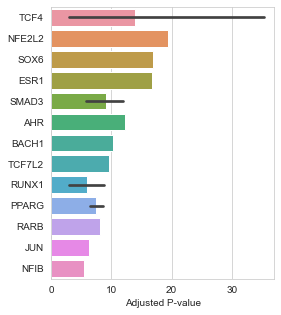

In [89]:
sig = overlap_chea[overlap_chea['Adjusted P-value'] < 0.05]

plt.figure(figsize = (4,5))
sns.barplot(x = -np.log(sig['Adjusted P-value']), 
            y = [i.split(' ')[0] for i in sig['Term']])

# Pseudotimepoints for network inference

In [110]:
import os 
import magic
directory = 'network-inference'
fname = 'M2'

try:
    os.mkdir(op.join(f"./{directory}/"))
except FileExistsError:
    pass
tfs = list(set(tfs).intersection(set(adata.var_names)))

magic_operator = magic.MAGIC(verbose=True, solver="approximate")

scv.tl.velocity(adata, mode = 'deterministic', vkey = 'det_velocity')

adata.layers["t0"] = magic_operator.fit_transform(adata.layers["Ms"])
adata.layers["t1"] = magic_operator.transform(
    scv.utils.get_extrapolated_state(adata, vkey = 'det_velocity')
)
t0 = pd.DataFrame(
    adata[:, tfs].layers["t0"], index=adata.obs_names, columns=tfs
)
t0.to_csv(f"./{directory}/t0_{fname}.csv")

t1 = pd.DataFrame(
    adata[:, tfs].layers["t1"], index=adata.obs_names, columns=tfs
)
t1.to_csv(f"./{directory}/t1_{fname}.csv")


computing velocities
    finished (0:00:03) --> added 
    'det_velocity', velocity vectors for each individual cell (adata.layers)
Calculating MAGIC...
  Running MAGIC on 4388 cells and 15728 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 1.99 seconds.
    Calculating KNN search...
    Calculated KNN search in 0.72 seconds.
    Calculating affinities...
    Calculated affinities in 0.68 seconds.
  Calculated graph and diffusion operator in 3.39 seconds.
  Calculating imputation...
  Calculated imputation in 0.02 seconds.
Calculated MAGIC in 4.07 seconds.
Calculating PCA...
Calculated PCA in 2.25 seconds.
Calculating imputation...
Calculated imputation in 0.02 seconds.


NameError: name 'clusters' is not defined

In [111]:
clusters = 'identity'
network_clusters = pd.DataFrame(adata.obs[clusters])
network_clusters.to_csv(f"./{directory}/{fname}_clusters.csv")

# CTRP

Not done yet on M2

In [2]:
adata = sc.read_h5ad('../../data/M2/adata_04_nodub.h5ad')


In [5]:
vk = VelocityKernel(adata)
vk.compute_transition_matrix()

  0%|          | 0/4388 [00:00<?, ?cell/s]

  0%|          | 0/4388 [00:00<?, ?cell/s]

<VelocityKernel>

In [80]:
mb.ps.ctrp_simplified(adata,distance_basis='X_pca', T = vk.transition_matrix)



(4330, 4330)
Eigenvalues:  [1.]
    identified 1 end points
[[0.00699053 0.02274474 0.00905584 ... 0.00164962 0.00105905 0.00286188]
 [0.0043257  0.01031533 0.00439115 ... 0.04271931 0.0010535  0.02007914]
 [0.01118221 0.0581232  0.01489882 ... 0.00164536 0.00089986 0.00278402]
 ...
 [0.02943585 0.07718452 0.04069262 ... 0.00290873 0.00123456 0.0043487 ]
 [0.01248805 0.05092505 0.01584305 ... 0.00191142 0.0010818  0.0034755 ]
 [0.01319515 0.07138404 0.01565442 ... 0.00167594 0.00104796 0.00304012]]


<AxesSubplot:title={'center':'ctrp'}>

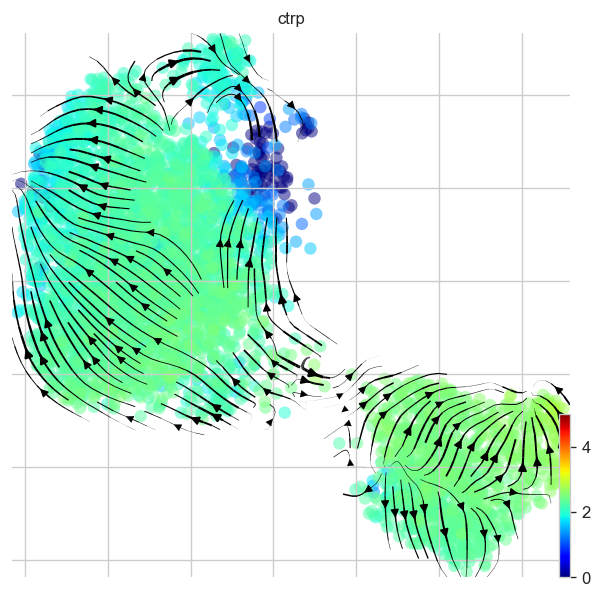

In [81]:
scv.pl.velocity_embedding_stream(adata, color='ctrp', show=False, color_map='jet', alpha=0.5, basis='umap', dpi=120,
                    zorder=1,figsize=(6,6), vmax = 5)

<AxesSubplot:title={'center':'identity'}>

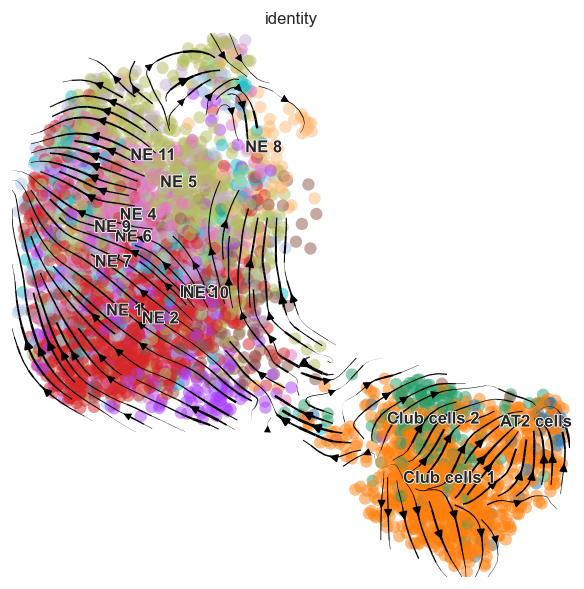

In [8]:
scv.pl.velocity_embedding_stream(adata, color='identity', show=False, color_map='jet', alpha=0.5, basis='umap', dpi=120,
                    zorder=1,figsize=(6,6), vmax = 5)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13]),
 [Text(0, 0, 'NE_8'),
  Text(1, 0, 'NE_9'),
  Text(2, 0, 'NE_7'),
  Text(3, 0, 'NE_6'),
  Text(4, 0, 'NE_2'),
  Text(5, 0, 'NE_11'),
  Text(6, 0, 'NE_4'),
  Text(7, 0, 'NE_5'),
  Text(8, 0, 'NE_10'),
  Text(9, 0, 'NE_3'),
  Text(10, 0, 'NE_1'),
  Text(11, 0, 'Club cells_1'),
  Text(12, 0, 'Club cells_2'),
  Text(13, 0, 'AT2 cells')])

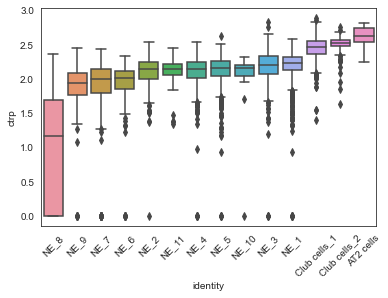

In [9]:
from statannot import add_stat_annotation
df = adata.obs[['identity','ctrp']].pivot(columns='identity')
df.columns = df.columns.droplevel(0)
sorted_index = df.median().sort_values().index
plt.figure(figsize=(6,4))
ax = sns.boxplot(data = adata.obs, x='identity',y = 'ctrp',#palette=[cp[5],cp[0],cp[2],cp[4],cp[3],cp[1],cp[6],],
                order = sorted_index)
plt.xticks(rotation = 45)

In [10]:
# from statannot import add_stat_annotation
# df = adata.obs[['subtype','ctrp']].pivot(columns='subtype')
# df.columns = df.columns.droplevel(0)
# sorted_index = df.median().sort_values().index
# plt.figure(figsize=(6,4))
# ax = sns.boxplot(data = adata.obs, x='subtype',y = 'ctrp',#palette=[cp[5],cp[0],cp[2],cp[4],cp[3],cp[1],cp[6],],
#                 order = sorted_index)
# plt.xticks(rotation = 45)

In [11]:
# from statannot import add_stat_annotation
# for day in adata.obs.timepoint.cat.categories:
    
#     df = adata[adata.obs.timepoint == day].obs[['subtype','ctrp']].pivot(columns='subtype')
#     df.columns = df.columns.droplevel(0)
#     sorted_index = df.median().sort_values().index
#     plt.figure(figsize=(6,4))
#     ax = sns.boxplot(data = adata.obs, x='subtype',y = 'ctrp',#palette=[cp[5],cp[0],cp[2],cp[4],cp[3],cp[1],cp[6],],
#                     order = sorted_index)
#     plt.xticks(rotation = 45)
#     plt.title(day)
#     plt.show()

<Graph object, directed, with 0 vertices and 0 edges, at 0x7fc3095b7b50>